### Student Details

In [1]:
#Student Names: Aman Anand
#Student Reg. No.: 19BCE0521
#Course and Slot: Web Mining_CSE3024 (C1/L39+L40)
#Faculty: Shashank Mouli Satapathy
#Group Number: 2
#Datasets Used - DelhiWeather.csv and plants.csv

### Imported Libraries

In [2]:
import pandas as pd
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
import numpy as np
import re
from sklearn.datasets import make_blobs
from sklearn.cluster import Birch
from sklearn.preprocessing import LabelEncoder , OneHotEncoder
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
pd.options.mode.chained_assignment = None
import warnings
warnings.filterwarnings('ignore')
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score

### Clustering
1. Hierarchical Clustering (Use Euclidian Distance Function)
2. BIRCH Clustering

#### Reading the dataset

In [3]:
#Read the dataset
with open('plantss.csv') as file: 
    numberCols = max(len(line.split(','))for line in file)
    file.seek(0);  
    plantDF = pd.read_csv(file, names=range(numberCols), dtype='unicode', header=None, error_bad_lines=False, index_col=False)

#Display top 5 rows
plantDF.head(5)

,0,1,2,3,4,5,6,7,8,9,...,60,61,62,63,64,65,66,67,68,69
0,ï»¿abelia,fl,nc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,abelia x grandiflora,fl,nc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,abelmoschus,ct,dc,fl,hi,il,ky,la,md,mi,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,abelmoschus esculentus,ct,dc,fl,il,ky,la,md,mi,ms,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,abelmoschus moschatus,hi,pr,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Processing the dataset

In [4]:
#Define and initialize LabelEncoder
le = LabelEncoder()
#Assign X to the flower names and encode them to numeric values
x = le.fit_transform(plantDF[0])
#Assign Y to all the state names/abbrv. concatenated as a string and encode them
y = pd.Series(plantDF.iloc[:,1:].fillna('').values.tolist()).str.join('')
y=le.fit_transform(y)
#Create a dataframe with the two encoded columns
x=list(x)
y=list(y)
plantDF1=pd.DataFrame({'A':x,"B":y})
#As it is a very large dataset, the entire modeling is carried out on top thousand rows to preserve the system
plantDF2=plantDF1.head(1000)
#Display the dataset hence created
plantDF2

,A,B
0,34780,9282
1,0,9282
2,1,8270
3,2,8271
4,3,9420
...,...,...
995,987,7172
996,1025,8876
997,988,7799
998,989,10530


#### Hierarchial (Agglomerative) Clustering & Dendrogram

In [5]:
#Create a model based on Agglomerative (Hierarchial) Clustering
aggModel = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='average')
#Fit the model to the dataset (1000 rows)
aggModel.fit(plantDF2)
labels = (aggModel.labels_)
#Plot and save the dendrogram
plt.figure(figsize=(50, 20),dpi=400)  
plt.title("Dendrogram using Average Linkage and Euclidian Distance as a measure",loc='center')
dendrogram = sch.dendrogram(sch.linkage(plantDF2, method='average'))
plt.savefig('dendrogram.jpg', bbox_inches='tight')
plt.show()

#### BIRCH Clustering

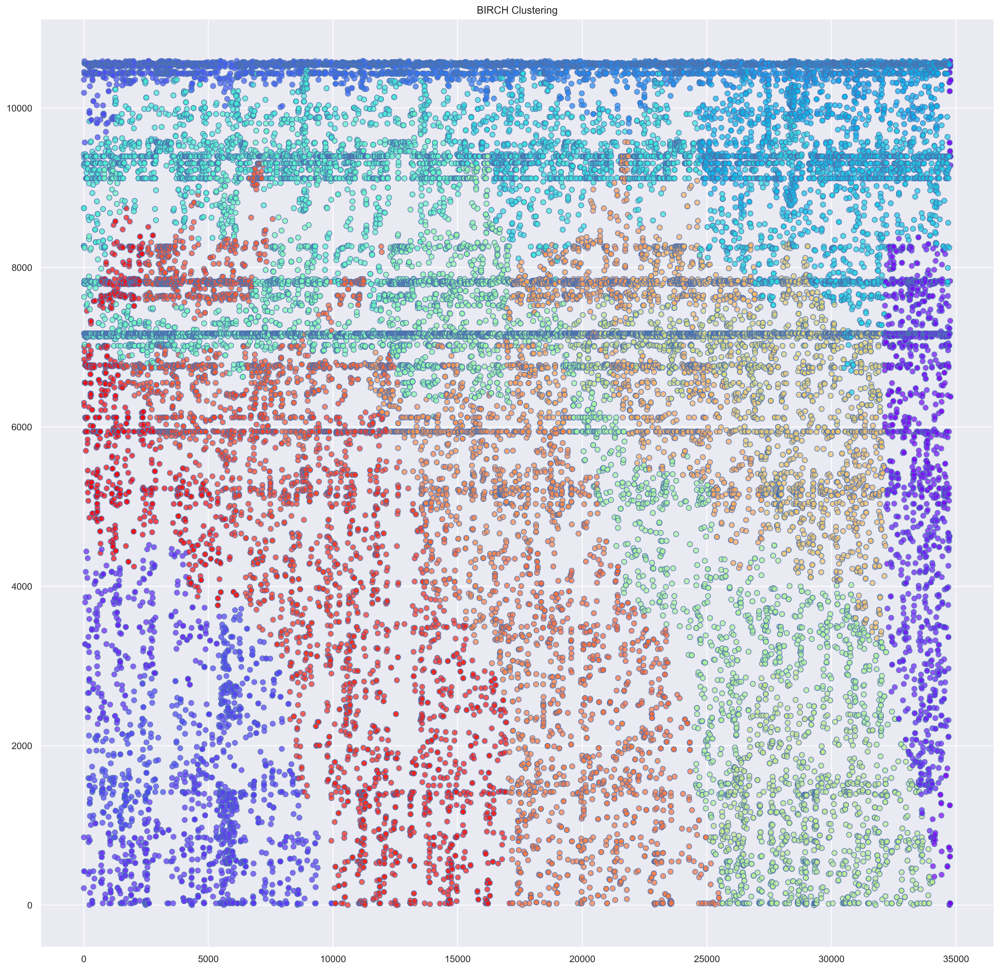

In [6]:
#Create a modle based on BIRCH clustering algorithm
birchModel = Birch(branching_factor = 50, n_clusters = None, threshold = 1.5)
#Fit the model on the original dataset to get a more exact plot
birchModel.fit(plantDF1)
pred = birchModel.predict(plantDF1)
#Plot and save the scatterplot
plt.figure(figsize=(20, 20),dpi=400)  
plt.title("BIRCH Clustering",loc='center')
plt.scatter(plantDF1.iloc[:,0],plantDF1.iloc[:,1], c = pred, cmap = 'rainbow', alpha = 0.7, edgecolors = 'b')
plt.savefig('BIRCHplot.jpg', bbox_inches='tight')
plt.show()

### Classification
1. Naive-Bayes
2. Gradient Boosting

#### Reading the Dataset

In [7]:
#Load the dataset
df = pd.read_csv("DelhiWeather.csv")
#Standardizing the attribute names (deleting extra space in attribute names)
df.columns = map(lambda x: x.strip(), df.columns)
#Display the top 5 rows
df.head()

,datetime_utc,_conds,_dewptm,_fog,_hail,_heatindexm,_hum,_precipm,_pressurem,_rain,_snow,_tempm,_thunder,_tornado,_vism,_wdird,_wdire,_wgustm,_windchillm,_wspdm
0,19961101-11:00,Smoke,9.0,0,0,NaN,27.0,NaN,1010.0,0,0,30.0,0,0,5.0,280.0,West,NaN,NaN,7.4
1,19961101-12:00,Smoke,10.0,0,0,NaN,32.0,NaN,-9999.0,0,0,28.0,0,0,NaN,0.0,North,NaN,NaN,NaN
2,19961101-13:00,Smoke,11.0,0,0,NaN,44.0,NaN,-9999.0,0,0,24.0,0,0,NaN,0.0,North,NaN,NaN,NaN
3,19961101-14:00,Smoke,10.0,0,0,NaN,41.0,NaN,1010.0,0,0,24.0,0,0,2.0,0.0,North,NaN,NaN,NaN
4,19961101-16:00,Smoke,11.0,0,0,NaN,47.0,NaN,1011.0,0,0,23.0,0,0,1.2,0.0,North,NaN,NaN,0.0


In [8]:
#_conds will be used as the feature attribute. Finding the number of unique conditions
df._conds.value_counts(ascending=False)

Haze                             47602
Smoke                            20760
Mist                              9375
Clear                             3129
Widespread Dust                   2856
Fog                               2760
Scattered Clouds                  2209
Partly Cloudy                     2091
Shallow Fog                       1860
Mostly Cloudy                     1537
Light Rain                        1302
Partial Fog                       1031
Patches of Fog                     901
Thunderstorms and Rain             486
Heavy Fog                          421
Light Drizzle                      414
Rain                               394
Unknown                            383
Blowing Sand                       378
Overcast                           326
Thunderstorm                       192
Light Thunderstorms and Rain       176
Drizzle                            112
Light Thunderstorm                  64
Light Fog                           64
Heavy Rain               

In [9]:
#Defining two function to extract the year and months in the record. Will help to process and clean the dataset
def extract_year(value):
    return (value[0:4])
def extract_month(value):
    return (value[4:6])

In [10]:
#Extracting month and year of data records
df["year"] = df["datetime_utc"].apply(lambda x:extract_year(x))
df["month"] = df["datetime_utc"].apply(lambda x:extract_month(x))
#Displaying top 5 elements
df.head()

,datetime_utc,_conds,_dewptm,_fog,_hail,_heatindexm,_hum,_precipm,_pressurem,_rain,...,_thunder,_tornado,_vism,_wdird,_wdire,_wgustm,_windchillm,_wspdm,year,month
0,19961101-11:00,Smoke,9.0,0,0,NaN,27.0,NaN,1010.0,0,...,0,0,5.0,280.0,West,NaN,NaN,7.4,1996,11
1,19961101-12:00,Smoke,10.0,0,0,NaN,32.0,NaN,-9999.0,0,...,0,0,NaN,0.0,North,NaN,NaN,NaN,1996,11
2,19961101-13:00,Smoke,11.0,0,0,NaN,44.0,NaN,-9999.0,0,...,0,0,NaN,0.0,North,NaN,NaN,NaN,1996,11
3,19961101-14:00,Smoke,10.0,0,0,NaN,41.0,NaN,1010.0,0,...,0,0,2.0,0.0,North,NaN,NaN,NaN,1996,11
4,19961101-16:00,Smoke,11.0,0,0,NaN,47.0,NaN,1011.0,0,...,0,0,1.2,0.0,North,NaN,NaN,0.0,1996,11


#### Processing and cleaning the data

In [11]:
#Checking for null values
df.isnull().sum()

datetime_utc         0
_conds              72
_dewptm            621
_fog                 0
_hail                0
_heatindexm      71835
_hum               757
_precipm        100990
_pressurem         232
_rain                0
_snow                0
_tempm             673
_thunder             0
_tornado             0
_vism             4428
_wdird           14755
_wdire           14755
_wgustm          99918
_windchillm     100411
_wspdm            2358
year                 0
month                0
dtype: int64

In [12]:
#Filtering relevant attributes
df_filtered = df[['datetime_utc', '_conds', '_dewptm', '_fog', '_hail', '_hum', '_pressurem', '_rain', 
                  '_snow', '_tempm', '_thunder', '_tornado', '_vism', '_wdird', '_wdire', '_wspdm', 
                  'year', "month"]]

In [13]:
#As shown above there are several occurences of NaN/Null vbalues in the datasets. 
#We will iterate over all rows of the dataset where a certain attribute is NaN/Null
#Replace that value with mean/mode of that years records.

#Attribute: _dewptm
for index,row in df_filtered[df_filtered._dewptm.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._dewptm.mean()
    df_filtered.at[index, "_dewptm"] = mean_val

#Attribute: _hum
for index,row in df_filtered[df_filtered._hum.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._hum.mean()
    df_filtered.at[index, "_hum"] = mean_val
    
#Attribute: _pressurem 
df_filtered._pressurem.replace(-9999.0, np.nan, inplace=True)
for index,row in df_filtered[df_filtered._pressurem.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._pressurem.mean()
    df_filtered.at[index, "_pressurem"] = mean_val
    
#Attribute: _tempm
for index,row in df_filtered[df_filtered._tempm.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._tempm.mean()
    df_filtered.at[index, "_tempm"] = mean_val

#Attribute: _vism
for index,row in df_filtered[df_filtered._vism.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._vism.mean()
    df_filtered.at[index, "_vism"] = mean_val
    
#Attribute: _wdird
for index,row in df_filtered[df_filtered._wdird.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._wdird.mean()
    df_filtered.at[index, "_wdird"] = mean_val
    
#Attribute: _wspdm
for index,row in df_filtered[df_filtered._wspdm.isnull()].iterrows():
    mean_val = df_filtered[df_filtered["year"] == row["year"]]._wspdm.mean()
    df_filtered.at[index, "_wspdm"] = mean_val
    
#Attribute: _wdire
for index,row in df_filtered[df_filtered._wdire.isnull()].iterrows():
    most_frequent = df_filtered[df_filtered["year"] == row["year"]]._wdire.value_counts().idxmax()
    df_filtered.at[index, "_wdire"] = most_frequent

#Attribute: _conds
for index,row in df_filtered[df_filtered._conds.isnull()].iterrows():
    most_frequent = df_filtered[df_filtered["year"] == row["year"]]._conds.value_counts().idxmax()
    df_filtered.at[index, "_conds"] = most_frequent
    
#Check for null values
df_filtered.isnull().sum()

datetime_utc    0
_conds          0
_dewptm         0
_fog            0
_hail           0
_hum            0
_pressurem      0
_rain           0
_snow           0
_tempm          0
_thunder        0
_tornado        0
_vism           0
_wdird          0
_wdire          0
_wspdm          0
year            0
month           0
dtype: int64

In [14]:
df_filtered.year = df_filtered.year.astype("object")
df_filtered.month = df_filtered.month.astype("object")
pd.crosstab(df_filtered.year, [df_filtered.month], values=df_filtered._tempm, aggfunc="mean")
#Feature columns for the classification
feature_columns = ['_wdire', '_dewptm', '_fog', '_hail', '_hum', '_pressurem', '_rain', 
                   '_snow', '_tempm', '_thunder', '_tornado', '_vism', '_wdird', '_wspdm', 'year', 'month', '_conds']

In [15]:
#Create a new dataset, so that we dont change our filtered dataset
#Create dataset in such a way, _wdire(categorical feature in starting position & target variable at last which is _conds
df_final = df_filtered[feature_columns]
wdire_dummies = pd.get_dummies(df_final["_wdire"])
df_final = pd.concat([wdire_dummies, df_final], axis=1)
df_final.drop("_wdire", inplace=True, axis=1)
#Display top 5 rows of df_final
df_final.head()

,ENE,ESE,East,NE,NNE,NNW,NW,North,SE,SSE,...,_snow,_tempm,_thunder,_tornado,_vism,_wdird,_wspdm,year,month,_conds
0,0,0,0,0,0,0,0,0,0,0,...,0,30.0,0,0,5.000000,280.0,7.400000,1996,11,Smoke
1,0,0,0,0,0,0,0,1,0,0,...,0,28.0,0,0,2.198981,0.0,5.052735,1996,11,Smoke
2,0,0,0,0,0,0,0,1,0,0,...,0,24.0,0,0,2.198981,0.0,5.052735,1996,11,Smoke
3,0,0,0,0,0,0,0,1,0,0,...,0,24.0,0,0,2.000000,0.0,5.052735,1996,11,Smoke
4,0,0,0,0,0,0,0,1,0,0,...,0,23.0,0,0,1.200000,0.0,0.000000,1996,11,Smoke


#### Creating the testing and training data

In [16]:
label_encoder = LabelEncoder()
X = df_final.iloc[:, 0:-1].values
y = df_final.iloc[:, -1].values
y = label_encoder.fit_transform(y)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.25, random_state=0) # test size =0.25 or 25%

In [17]:
#Naive-Bayes Classification Technique

#Create a Gaussian Classifier
gnb = GaussianNB()

#Train the model using the training sets
gnb.fit(X_train, y_train)

#Predict the response for test dataset
Y_pred2 = gnb.predict(X_test)
print("\n------Naive Bayes------\n")

# Predicted values
print("Predicted values:",Y_pred2)

#Confusion Matrix
print("\nConfusion Matrix: \n\n",confusion_matrix(y_test, Y_pred2))

#Model Accuracy, how often is the classifier correct?
print("\nAccuracy:",metrics.accuracy_score(y_test, Y_pred2)*100)

# Report containing precision,recall,f1-score,support
print("\nReport--> \n",classification_report(y_test, Y_pred2))


------Naive Bayes------

Predicted values: [38 20 31 ... 20 21 23]

Confusion Matrix: 

 [[  0   0   0 ...   0   0  87]
 [  0   1   0 ...   0   0 459]
 [  0   0   0 ...   0   0   3]
 ...
 [  0   0   0 ...   0   0   2]
 [  0   0   0 ...   0   0  48]
 [  0   0   0 ...   0   0 669]]

Accuracy: 22.302756653992397

Report--> 
               precision    recall  f1-score   support

           0       0.00      0.00      0.00        90
           1       0.03      0.00      0.00       797
           2       0.00      0.00      0.00        28
           3       0.53      0.45      0.49       648
           5       0.47      0.00      0.00     11945
           6       0.17      0.19      0.18       120
           7       0.00      0.00      0.00         8
           8       0.00      0.00      0.00         2
           9       0.00      0.00      0.00         1
          10       0.00      0.00      0.00        89
          11       0.00      0.00      0.00        18
          14       0.00   

In [18]:
#Gradient Boosting Classificaiton Technique

#Create the GBC model
gbcModel = GradientBoostingClassifier()
# fit the model on the whole dataset
gbcModel.fit(X_train, y_train)
#Predict the response for test dataset
yhat = gbcModel.predict(X_test)
print("\n------Gradient Boosting------\n")

# Predicted values
print("Predicted values:",yhat)

#Confusion Matrix
print("\nConfusion Matrix: \n\n",confusion_matrix(y_test, yhat))

#Model Accuracy, how often is the classifier correct?
print("\nAccuracy:",metrics.accuracy_score(y_test, yhat)*100)

# Report containing precision,recall,f1-score,support
print("\nReport--> \n",classification_report(y_test, yhat))


------Gradient Boosting------

Predicted values: [29  5 31 ... 15  5 20]

Confusion Matrix: 

 [[ 46   0   0 ...   0   0  11]
 [  0 334   0 ...   0   0  17]
 [  0   0   1 ...   1   0   0]
 ...
 [  0  11   0 ...  15   3  10]
 [  0   0   0 ...   0   0   0]
 [  9  33   0 ...   3   0 353]]

Accuracy: 77.99429657794677

Report--> 
               precision    recall  f1-score   support

           0       0.72      0.51      0.60        90
           1       0.47      0.42      0.45       797
           2       0.04      0.04      0.04        28
           3       0.84      0.78      0.81       648
           5       0.82      0.90      0.86     11945
           6       0.57      0.57      0.57       120
           7       0.00      0.00      0.00         8
           8       0.00      0.00      0.00         2
           9       0.00      0.00      0.00         1
          10       0.21      0.04      0.07        89
          11       0.57      0.22      0.32        18
          14       0.